In [1]:
import os
import scipy.io
import scipy.misc
import numpy as np
import pandas as pd
import PIL
import struct
import cv2
from numpy import expand_dims
import tensorflow as tf
# from skimage.transform import resize
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, Conv2D, BatchNormalization, LeakyReLU, ZeroPadding2D, UpSampling2D
from tensorflow.keras.models import load_model, Model
from tensorflow.keras.layers import add, concatenate
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from matplotlib import pyplot
import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow
from matplotlib.patches import Rectangle

In [2]:
from platform import python_version

print(python_version())

3.9.13


In [3]:
class WeightReader:
    def __init__(self, weight_file):
        with open(weight_file, 'rb') as w_f:
            major, = struct.unpack('i', w_f.read(4))
            minor, = struct.unpack('i', w_f.read(4))
            revision, = struct.unpack('i', w_f.read(4))
            if (major * 10 + minor) >= 2 and major < 1000 and minor < 1000:
                w_f.read(8)
            else:
                w_f.read(4)
            transpose = (major > 1000) or (minor > 1000)
            binary = w_f.read()
        self.offset = 0
        self.all_weights = np.frombuffer(binary, dtype='float32')

    def read_bytes(self, size):
        self.offset = self.offset + size
        return self.all_weights[self.offset - size:self.offset]

    def load_weights(self, model):
        for i in range(106):
            try:
                conv_layer = model.get_layer('conv_' + str(i))
                print("loading weights of convolution #" + str(i))
                if i not in [81, 93, 105]:
                    norm_layer = model.get_layer('bnorm_' + str(i))
                    size = np.prod(norm_layer.get_weights()[0].shape)
                    beta = self.read_bytes(size)  # bias
                    gamma = self.read_bytes(size)  # scale
                    mean = self.read_bytes(size)  # mean
                    var = self.read_bytes(size)  # variance
                    weights = norm_layer.set_weights([gamma, beta, mean, var])
                if len(conv_layer.get_weights()) > 1:
                    bias = self.read_bytes(np.prod(conv_layer.get_weights()[1].shape))
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2, 3, 1, 0])
                    conv_layer.set_weights([kernel, bias])
                else:
                    kernel = self.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
                    kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
                    kernel = kernel.transpose([2, 3, 1, 0])
                    conv_layer.set_weights([kernel])
            except ValueError:
                print("no convolution #" + str(i))

    def reset(self):
        self.offset = 0


def _conv_block(inp, convs, skip=True):
    x = inp
    count = 0
    for conv in convs:
        if count == (len(convs) - 2) and skip:
            skip_connection = x
        count += 1
        if conv['stride'] > 1: x = ZeroPadding2D(((1, 0), (1, 0)))(x)  # peculiar padding as darknet prefer left and top
        x = Conv2D(conv['filter'],
                   conv['kernel'],
                   strides=conv['stride'],
                   padding='valid' if conv['stride'] > 1 else 'same',  # peculiar padding as darknet prefer left and top
                   name='conv_' + str(conv['layer_idx']),
                   use_bias=False if conv['bnorm'] else True)(x)
        if conv['bnorm']: x = BatchNormalization(epsilon=0.001, name='bnorm_' + str(conv['layer_idx']))(x)
        if conv['leaky']: x = LeakyReLU(alpha=0.1, name='leaky_' + str(conv['layer_idx']))(x)
    return add([skip_connection, x]) if skip else x


def make_yolov3_model():
    input_image = Input(shape=(None, None, 3))
    # Layer  0 => 4
    x = _conv_block(input_image,
                    [{'filter': 32, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 0},
                     {'filter': 64, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 1},
                     {'filter': 32, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 2},
                     {'filter': 64, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 3}])
    # Layer  5 => 8
    x = _conv_block(x, [{'filter': 128, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 5},
                        {'filter': 64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 6},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 7}])
    # Layer  9 => 11
    x = _conv_block(x, [{'filter': 64, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 9},
                        {'filter': 128, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 10}])
    # Layer 12 => 15
    x = _conv_block(x, [{'filter': 256, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 12},
                        {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 13},
                        {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 14}])
    # Layer 16 => 36
    for i in range(7):
        x = _conv_block(x, [
            {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 16 + i * 3},
            {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 17 + i * 3}])
    skip_36 = x
    # Layer 37 => 40
    x = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 37},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 38},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 39}])
    # Layer 41 => 61
    for i in range(7):
        x = _conv_block(x, [
            {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 41 + i * 3},
            {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 42 + i * 3}])
    skip_61 = x
    # Layer 62 => 65
    x = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 2, 'bnorm': True, 'leaky': True, 'layer_idx': 62},
                        {'filter': 512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 63},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 64}])
    # Layer 66 => 74
    for i in range(3):
        x = _conv_block(x, [
            {'filter': 512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 66 + i * 3},
            {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 67 + i * 3}])
    # Layer 75 => 79
    x = _conv_block(x, [{'filter': 512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 75},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 76},
                        {'filter': 512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 77},
                        {'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 78},
                        {'filter': 512, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 79}],
                    skip=False)
    # Layer 80 => 82
    yolo_82 = _conv_block(x, [{'filter': 1024, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 80},
                              {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False,
                               'layer_idx': 81}], skip=False)
    # Layer 83 => 86
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 84}],
                    skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_61])
    # Layer 87 => 91
    x = _conv_block(x, [{'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 87},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 88},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 89},
                        {'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 90},
                        {'filter': 256, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 91}],
                    skip=False)
    # Layer 92 => 94
    yolo_94 = _conv_block(x, [{'filter': 512, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 92},
                              {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False,
                               'layer_idx': 93}], skip=False)
    # Layer 95 => 98
    x = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 96}],
                    skip=False)
    x = UpSampling2D(2)(x)
    x = concatenate([x, skip_36])
    # Layer 99 => 106
    yolo_106 = _conv_block(x, [{'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True, 'layer_idx': 99},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True,
                                'layer_idx': 100},
                               {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True,
                                'layer_idx': 101},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True,
                                'layer_idx': 102},
                               {'filter': 128, 'kernel': 1, 'stride': 1, 'bnorm': True, 'leaky': True,
                                'layer_idx': 103},
                               {'filter': 256, 'kernel': 3, 'stride': 1, 'bnorm': True, 'leaky': True,
                                'layer_idx': 104},
                               {'filter': 255, 'kernel': 1, 'stride': 1, 'bnorm': False, 'leaky': False,
                                'layer_idx': 105}], skip=False)
    model = Model(input_image, [yolo_82, yolo_94, yolo_106])
    return model


def load_image_pixels(filename, shape):
    # load image to get its shape
    image = cv2.imread(filename)
    width = image.shape[1]
    height = image.shape[0]

    # load image with required size
    image = cv2.resize(image, shape, interpolation = cv2.INTER_AREA)
    image = img_to_array(image)

    # grayscale image normalization
    image = image.astype('float32')
    image /= 255.0

    # add a dimension so that we have one sample
    image = expand_dims(image, 0)
    return image, width, height


class BoundBox:
    def __init__(self, xmin, ymin, xmax, ymax, objness=None, classes=None):
        self.xmin = xmin
        self.ymin = ymin
        self.xmax = xmax
        self.ymax = ymax
        self.objness = objness
        self.classes = classes
        self.label = -1
        self.score = -1

    def get_label(self):
        if self.label == -1:
            self.label = np.argmax(self.classes)

        return self.label

    def get_score(self):
        if self.score == -1:
            self.score = self.classes[self.get_label()]
        return self.get_score


def _sigmoid(x):
    return 1. / (1. + np.exp(-x))


def decode_netout(netout, anchors, obj_thresh, net_h, net_w):
    grid_h, grid_w = netout.shape[:2]
    nb_box = 3
    netout = netout.reshape((grid_h, grid_w, nb_box, -1))
    nb_class = netout.shape[-1] - 5
    boxes = []
    netout[..., :2] = _sigmoid(netout[..., :2])
    netout[..., 4:] = _sigmoid(netout[..., 4:])
    netout[..., 5:] = netout[..., 4][..., np.newaxis] * netout[..., 5:]
    netout[..., 5:] *= netout[..., 5:] > obj_thresh

    for i in range(grid_h * grid_w):
        row = i / grid_w
        col = i % grid_w
        for b in range(nb_box):
            # 4th element is objectness score
            objectness = netout[int(row)][int(col)][b][4]
            if (objectness.all() <= obj_thresh): continue
            # first 4 elements are x, y, w, and h
            x, y, w, h = netout[int(row)][int(col)][b][:4]
            x = (col + x) / grid_w  # center position, unit: image width
            y = (row + y) / grid_h  # center position, unit: image height
            w = anchors[2 * b + 0] * np.exp(w) / net_w  # unit: image width
            h = anchors[2 * b + 1] * np.exp(h) / net_h  # unit: image height
            # last elements are class probabilities
            classes = netout[int(row)][col][b][5:]
            box = BoundBox(x - w / 2, y - h / 2, x + w / 2, y + h / 2, objectness, classes)
            boxes.append(box)
    return boxes


def correct_yolo_boxes(boxes, image_h, image_w, net_h, net_w):
    new_w, new_h = net_w, net_h
    for i in range(len(boxes)):
        x_offset, x_scale = (net_w - new_w) / 2. / net_w, float(new_w) / net_w
        y_offset, y_scale = (net_h - new_h) / 2. / net_h, float(new_h) / net_h
        boxes[i].xmin = int((boxes[i].xmin - x_offset) / x_scale * image_w)
        boxes[i].xmax = int((boxes[i].xmax - x_offset) / x_scale * image_w)
        boxes[i].ymin = int((boxes[i].ymin - y_offset) / y_scale * image_h)
        boxes[i].ymax = int((boxes[i].ymax - y_offset) / y_scale * image_h)


def _interval_overlap(interval_a, interval_b):
    x1, x2 = interval_a
    x3, x4 = interval_b
    if x3 < x1:
        if x4 < x1:
            return 0
        else:
            return min(x2, x4) - x1
    else:
        if x2 < x3:
            return 0
        else:
            return min(x2, x4) - x3


def bbox_iou(box1, box2):
    intersect_w = _interval_overlap([box1.xmin, box1.xmax], [box2.xmin, box2.xmax])
    intersect_h = _interval_overlap([box1.ymin, box1.ymax], [box2.ymin, box2.ymax])
    intersect = intersect_w * intersect_h
    w1, h1 = box1.xmax - box1.xmin, box1.ymax - box1.ymin
    w2, h2 = box2.xmax - box2.xmin, box2.ymax - box2.ymin
    union = w1 * h1 + w2 * h2 - intersect
    return float(intersect) / union


def do_nms(boxes, nms_thresh):
    if len(boxes) > 0:
        nb_class = len(boxes[0].classes)
    else:
        return
    for c in range(nb_class):
        sorted_indices = np.argsort([-box.classes[c] for box in boxes])
        for i in range(len(sorted_indices)):
            index_i = sorted_indices[i]
            if boxes[index_i].classes[c] == 0: continue
            for j in range(i + 1, len(sorted_indices)):
                index_j = sorted_indices[j]
                if bbox_iou(boxes[index_i], boxes[index_j]) >= nms_thresh:
                    boxes[index_j].classes[c] = 0


# get all of the results above a threshold
def get_boxes(boxes, labels, thresh):
    v_boxes, v_labels, v_scores = list(), list(), list()
    # enumerate all boxes
    for box in boxes:
        # enumerate all possible labels
        for i in range(len(labels)):
            # check if the threshold for this label is high enough
            if box.classes[i] > thresh:
                v_boxes.append(box)
                v_labels.append(labels[i])
                v_scores.append(box.classes[i] * 100)
            # don't break, many labels may trigger for one box
    return v_boxes, v_labels, v_scores


# draw all results
def draw_boxes(filename, v_boxes, v_labels, v_scores):
    # load the image
    data = pyplot.imread(filename)
    # plot the image
    pyplot.imshow(data)
    # get the context for drawing boxes
    ax = pyplot.gca()
    # plot each box
    for i in range(len(v_boxes)):
        box = v_boxes[i]
        # get coordinates
        y1, x1, y2, x2 = box.ymin, box.xmin, box.ymax, box.xmax
        # calculate width and height of the box
        width, height = x2 - x1, y2 - y1
        # create the shape
        rect = Rectangle((x1, y1), width, height, fill=False, color='red', linewidth=2)
        # draw the box
        ax.add_patch(rect)
        # draw text and score in top left corner
        label = "%s (%.3f)" % (v_labels[i], v_scores[i])
        pyplot.text(x1, y1, label, color='red')
    # show the plot
    pyplot.show()

In [4]:
# define the anchors
anchors = [[116, 90, 156, 198, 373, 326], [30, 61, 62, 45, 59, 119], [10, 13, 16, 30, 33, 23]]

# define the probability threshold for detected objects
class_threshold = 0.6

# define the labels
labels = ["person", "bicycle", "car", "motorbike", "aeroplane", "bus", "train", "truck",
          "boat", "traffic light", "fire hydrant", "stop sign", "parking meter", "bench",
          "bird", "cat", "dog", "horse", "sheep", "cow", "elephant", "bear", "zebra", "giraffe",
          "backpack", "umbrella", "handbag", "tie", "suitcase", "frisbee", "skis", "snowboard",
          "sports ball", "kite", "baseball bat", "baseball glove", "skateboard", "surfboard",
          "tennis racket", "bottle", "wine glass", "cup", "fork", "knife", "spoon", "bowl", "banana",
          "apple", "sandwich", "orange", "broccoli", "carrot", "hot dog", "pizza", "donut", "cake",
          "chair", "sofa", "pottedplant", "bed", "diningtable", "toilet", "tvmonitor", "laptop", "mouse",
          "remote", "keyboard", "cell phone", "microwave", "oven", "toaster", "sink", "refrigerator",
          "book", "clock", "vase", "scissors", "teddy bear", "hair drier", "toothbrush"]

# define the yolo v3 model
yolov3 = make_yolov3_model()

# load the weights
weight_reader = WeightReader('C:/Users/likwo/Desktop/6104/yolov3.weights')

# set the weights
weight_reader.load_weights(yolov3)



loading weights of convolution #0
loading weights of convolution #1
loading weights of convolution #2
loading weights of convolution #3
no convolution #4
loading weights of convolution #5
loading weights of convolution #6
loading weights of convolution #7
no convolution #8
loading weights of convolution #9
loading weights of convolution #10
no convolution #11
loading weights of convolution #12
loading weights of convolution #13
loading weights of convolution #14
no convolution #15
loading weights of convolution #16
loading weights of convolution #17
no convolution #18
loading weights of convolution #19
loading weights of convolution #20
no convolution #21
loading weights of convolution #22
loading weights of convolution #23
no convolution #24
loading weights of convolution #25
loading weights of convolution #26
no convolution #27
loading weights of convolution #28
loading weights of convolution #29
no convolution #30
loading weights of convolution #31
loading weights of convolution #32

1/1 [==============================] - 1s 1s/step
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 99.79894161224365


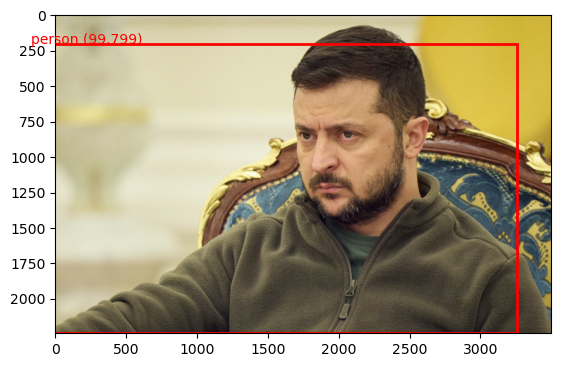

1/1 [==============================] - 0s 312ms/step
[(1, 13, 13, 255), (1, 26, 26, 255), (1, 52, 52, 255)]
person 97.0123827457428
person 99.83158111572266
person 99.65396523475647


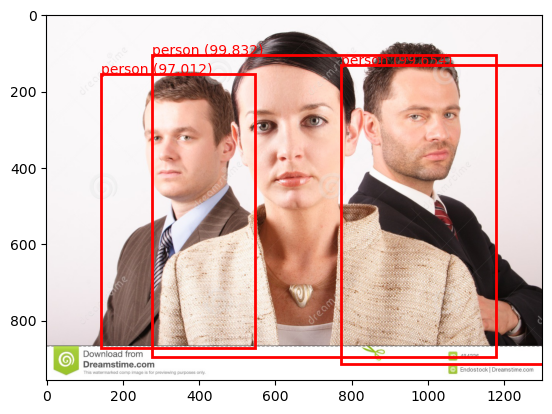

In [5]:
# save the model to file, optional
# yolov3.save('model.h5')
image_list = [ 'C:/Users/likwo/Desktop/6104/person.jpg','C:/Users/likwo/Desktop/6104/3_persons.jpg']
input_w, input_h = 416, 416

for photo_filename in image_list:
    image, image_w, image_h = load_image_pixels(photo_filename, (input_w, input_h))
    # make prediction
    yhat = yolov3.predict(image)
    # summarize the shape of the list of arrays
    print([a.shape for a in yhat])

    boxes = list()
    for i in range(len(yhat)):
      # decode the output of the network
      boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)

    # correct the sizes of the bounding boxes for the shape of the image
    correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)

    # suppress non-maximal boxes
    do_nms(boxes, 0.5)

    # get the details of the detected objects
    v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)

    # summarize what we found
    for i in range(len(v_boxes)):
      print(v_labels[i], v_scores[i])

    # draw what we found
    draw_boxes(photo_filename, v_boxes, v_labels, v_scores)

# Part A change to openCV2 function for loading image and resize
#     def load_image_pixels(filename, shape):
#     # load image to get its shape
#     image = cv2.imread(filename)
#     width = image.shape[1]
#     height = image.shape[0]

#     # load image with required size
#     image = cv2.resize(image, shape, interpolation = cv2.INTER_AREA)
#     image = img_to_array(image)

#     # grayscale image normalization
#     image = image.astype('float32')
#     image /= 255.0

#     # add a dimension so that we have one sample
#     image = expand_dims(image, 0)
#     return image, width, height

In [6]:
#part B

In [120]:
cap = cv2.VideoCapture('C:/Users/likwo/Desktop/6104/ppl_count.mp4')

In [8]:
# if cap.isOpened() is False: 
#    print("Error opening video stream or file")

In [9]:
#part B
#Error in drawing retangual, incorrect coor

In [121]:
os.remove('C:/Users/likwo/Desktop/6104/ppl_count_detected_count.mp4')

In [122]:
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
result = cv2.VideoWriter('C:/Users/likwo/Desktop/6104/ppl_count_detected_count.mp4', fourcc, 30, (input_w, input_h), True)

1/1 [==============================] - 1s 969ms/step
person 94.32852864265442
person 87.87748217582703
[(0, 0)]
0 0 10


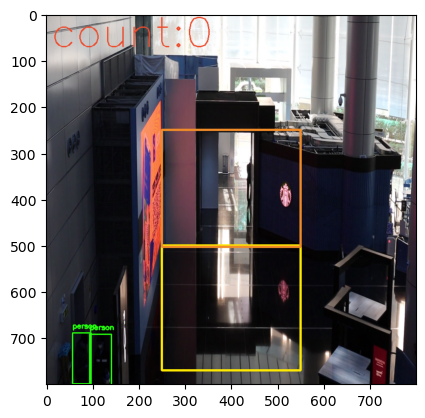

1/1 [==============================] - 1s 952ms/step
person 94.5648729801178
person 82.76031017303467
[(0, 0), (1, 0)]
1 0 11


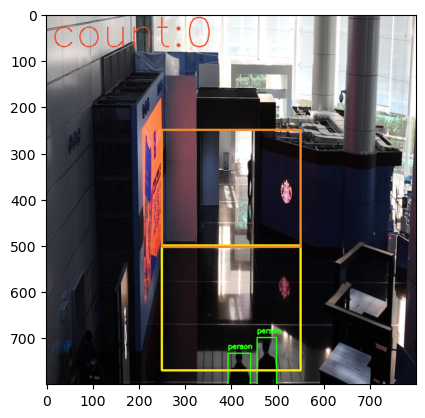

1/1 [==============================] - 1s 928ms/step
person 99.60910677909851
person 99.55620169639587
person 95.11047601699829
handbag 82.82539248466492
[(0, 0), (1, 0), (2, 0)]
2 0 12
cy: 2 co: 0 count: 0 pre_yellow: 0 pre_frame: 1 2


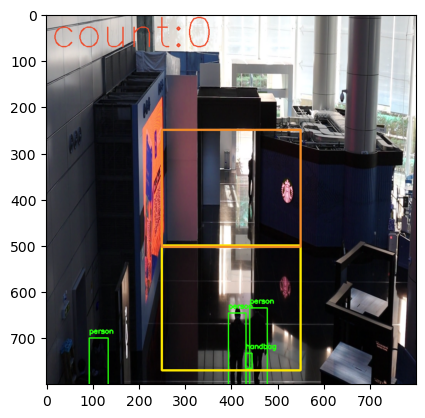

1/1 [==============================] - 1s 942ms/step
person 98.36148619651794
person 91.34603142738342
person 96.87379002571106
[(0, 0), (1, 0), (2, 0), (2, 0)]
2 0 13
cy: 2 co: 0 count: 0 pre_yellow: 0 pre_frame: 1 3


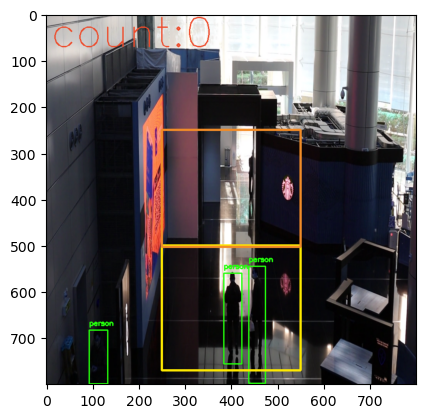

1/1 [==============================] - 1s 915ms/step
person 84.94652509689331
person 79.31295037269592
person 98.21978807449341
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0)]
2 0 14
cy: 2 co: 0 count: 0 pre_yellow: 0 pre_frame: 1 4


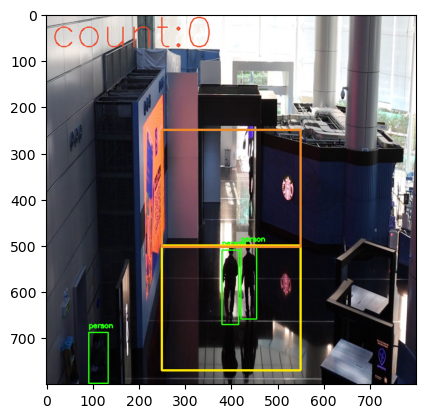

1/1 [==============================] - 1s 928ms/step
person 99.04853701591492
person 92.7363395690918
person 95.20936608314514
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0)]
2 0 15
cy: 2 co: 0 count: 0 pre_yellow: 0 pre_frame: 1 5


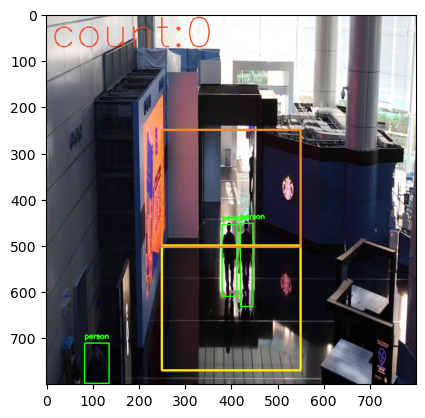

1/1 [==============================] - 1s 935ms/step
person 63.21174502372742
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1)]
0 1 16
cy: 0 co: 1 count: 0 pre_yellow: 0 pre_frame: 1 6


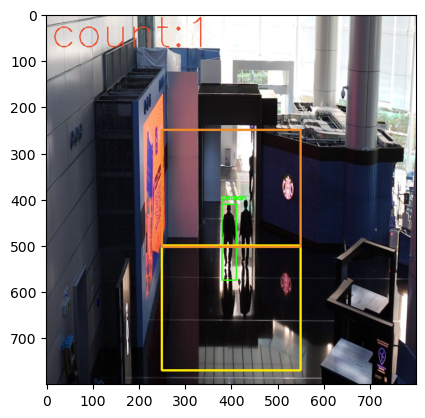

1/1 [==============================] - 1s 926ms/step
person 98.33714365959167
person 97.9158341884613
person 78.36493253707886
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2)]
0 2 17
cy: 0 co: 2 count: 1 pre_yellow: 2 pre_frame: 2 7


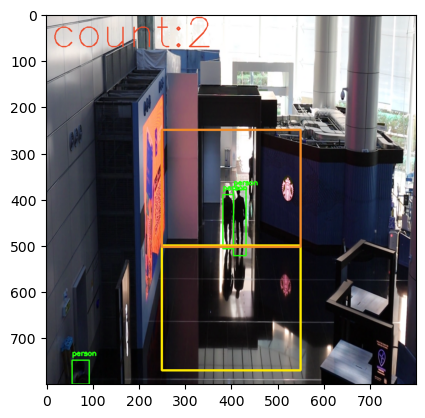

1/1 [==============================] - 1s 965ms/step
person 98.5477864742279
person 98.78244400024414
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2)]
0 2 18
cy: 0 co: 2 count: 2 pre_yellow: 2 pre_frame: 1 8


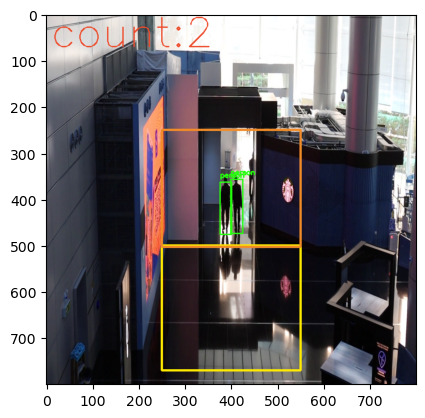

1/1 [==============================] - 1s 932ms/step
person 98.14984798431396
person 98.40829372406006
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2)]
0 2 19
cy: 0 co: 2 count: 2 pre_yellow: 2 pre_frame: 1 9


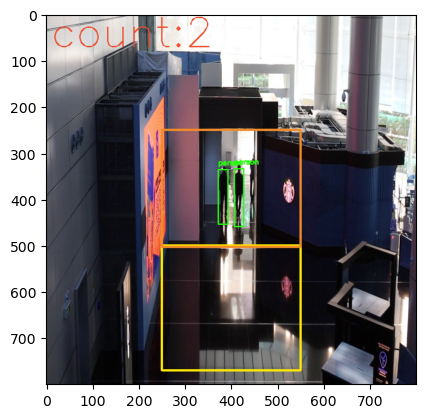

1/1 [==============================] - 1s 968ms/step
person 97.54725694656372
person 98.30335974693298
person 72.3333477973938
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3)]
0 3 20
cy: 0 co: 3 count: 2 pre_yellow: 2 pre_frame: 1 10


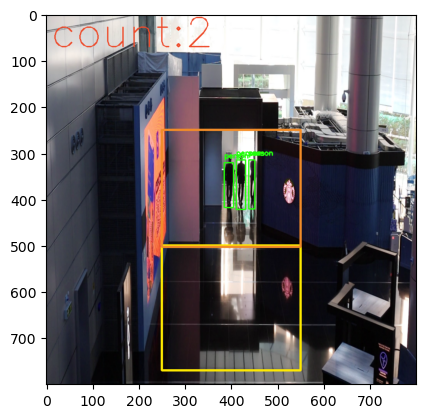

1/1 [==============================] - 1s 933ms/step
person 99.09511208534241
person 82.2039544582367
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2)]
0 2 21
cy: 0 co: 2 count: 2 pre_yellow: 2 pre_frame: 1 11


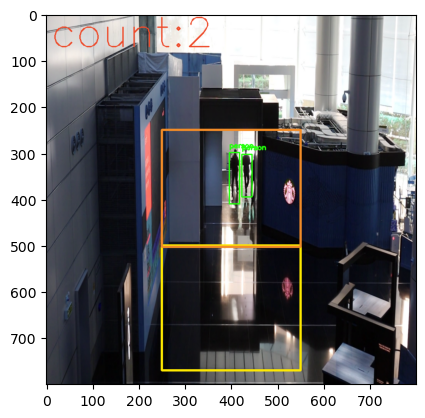

1/1 [==============================] - 1s 981ms/step
person 95.86014151573181
person 93.59716773033142
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2)]
0 2 22
cy: 0 co: 2 count: 2 pre_yellow: 2 pre_frame: 1 12


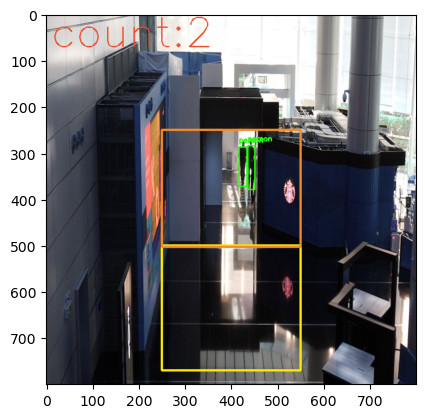

1/1 [==============================] - 1s 976ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0)]
0 0 23


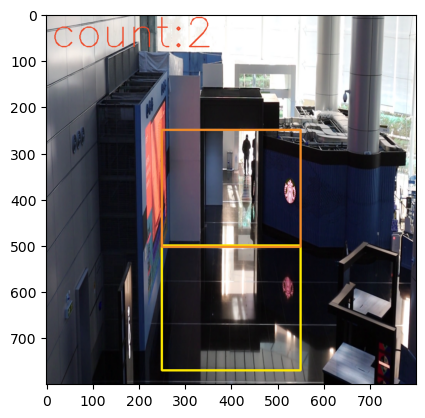

1/1 [==============================] - 1s 972ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0)]
0 0 24


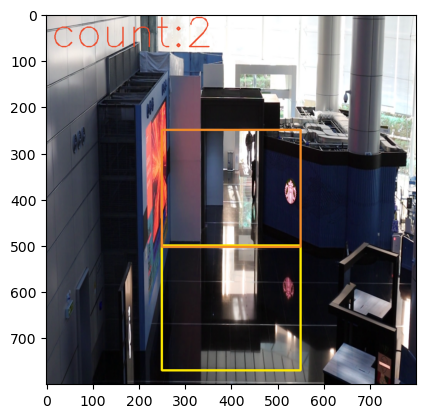

1/1 [==============================] - 1s 925ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0)]
0 0 25


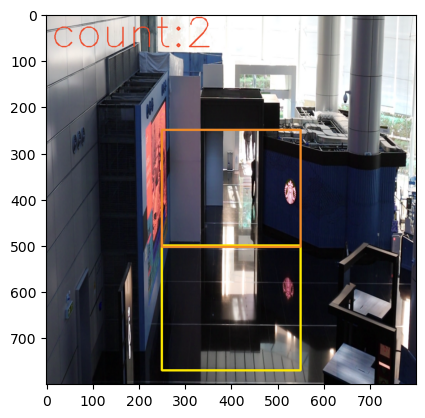

1/1 [==============================] - 1s 968ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 26


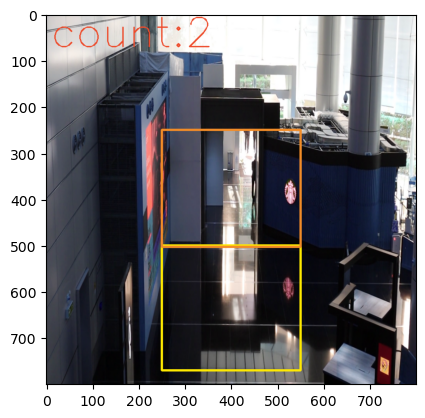

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 27


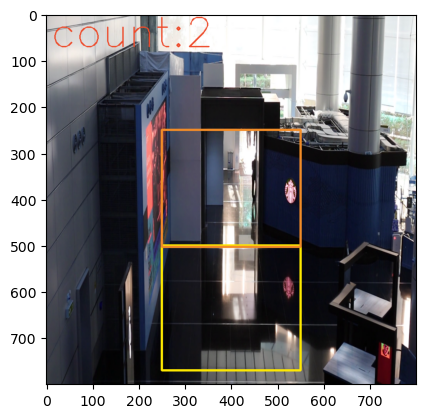

1/1 [==============================] - 1s 966ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 28


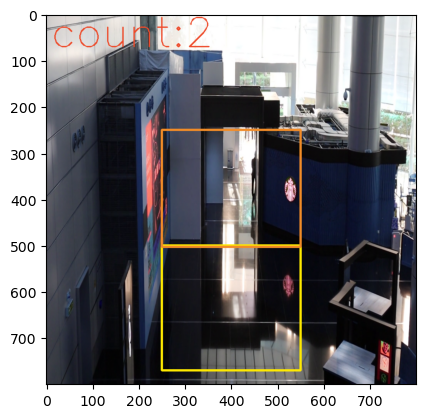

1/1 [==============================] - 1s 949ms/step
person 96.15422487258911
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 29


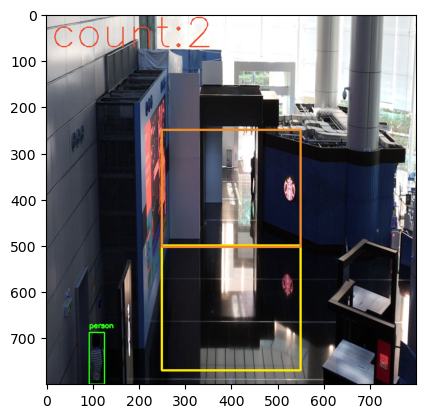

1/1 [==============================] - 1s 947ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 30


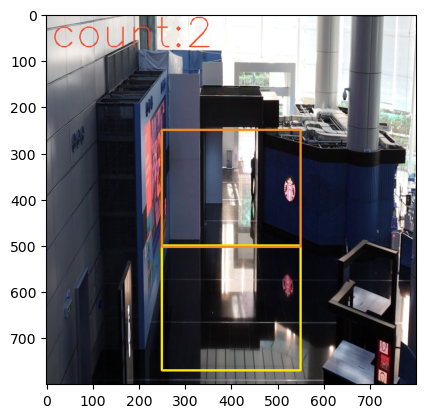

1/1 [==============================] - 1s 926ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 31


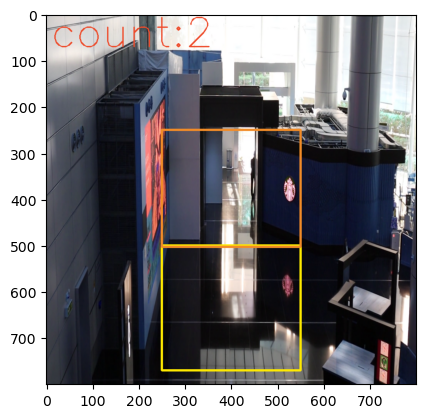

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 32


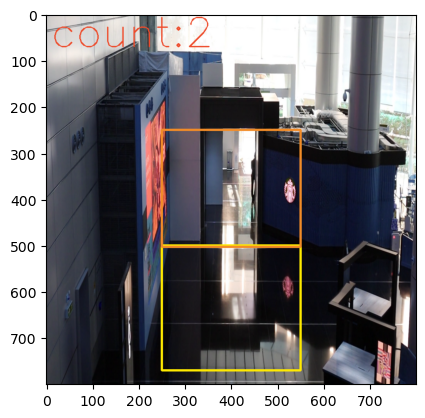

1/1 [==============================] - 1s 928ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 33


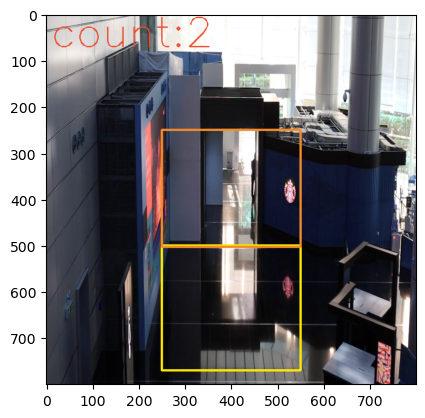

1/1 [==============================] - 1s 949ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 34


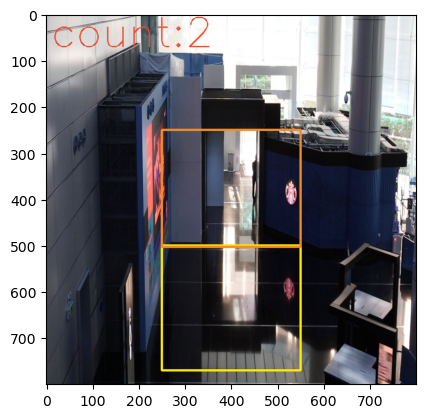

1/1 [==============================] - 1s 984ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 35


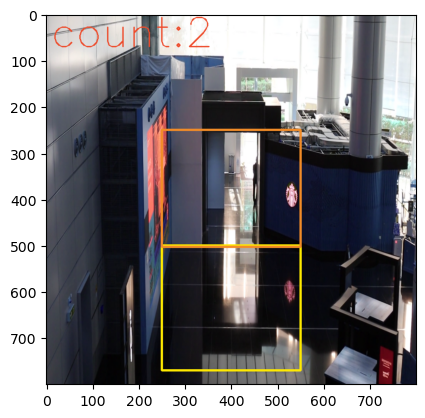

1/1 [==============================] - 1s 939ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 36


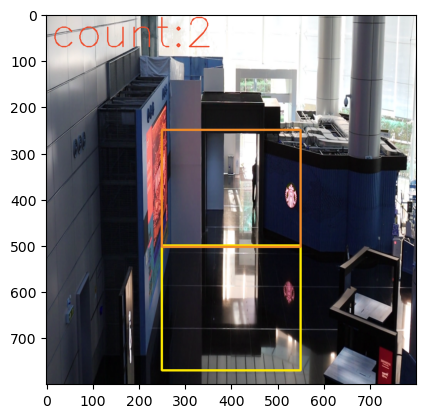

1/1 [==============================] - 1s 923ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 37


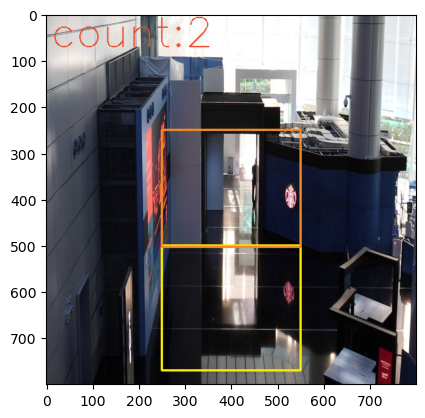

1/1 [==============================] - 1s 984ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 38


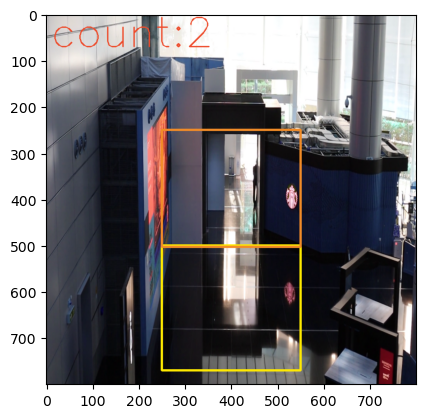

1/1 [==============================] - 1s 943ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 39


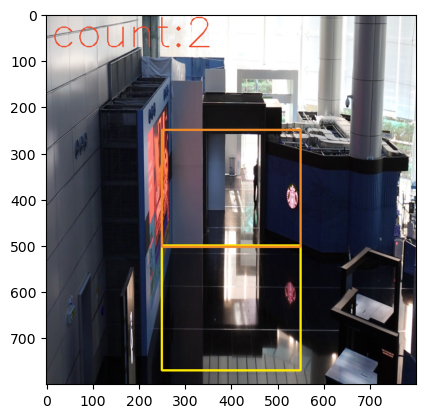

1/1 [==============================] - 1s 933ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 40


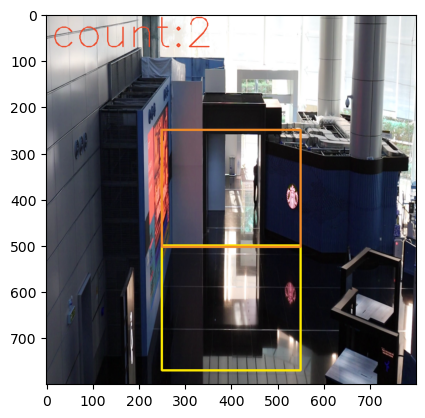

1/1 [==============================] - 1s 929ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 41


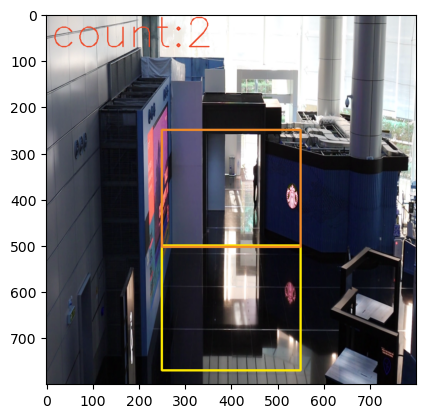

1/1 [==============================] - 1s 940ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 42


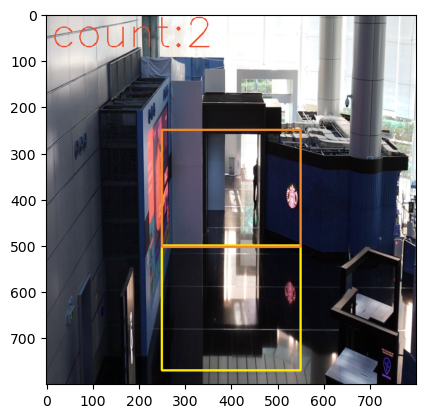

1/1 [==============================] - 1s 933ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 43


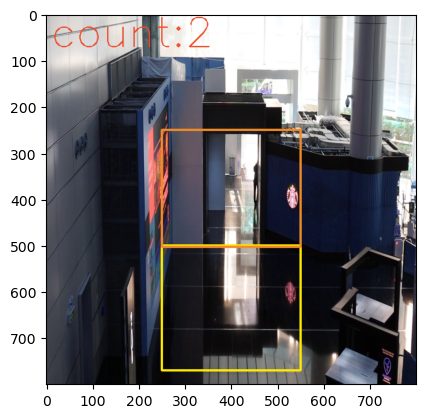

1/1 [==============================] - 1s 998ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 44


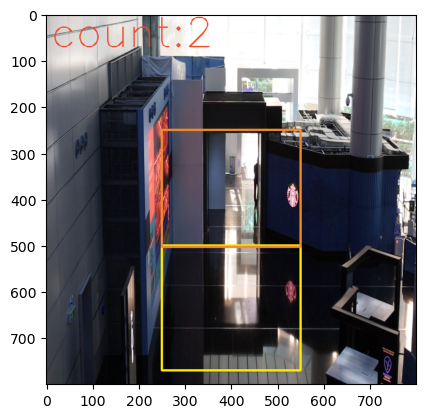

1/1 [==============================] - 1s 987ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 45


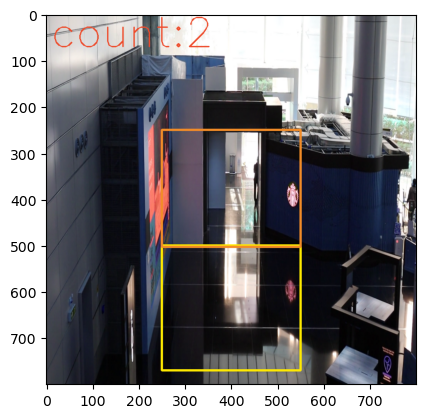

1/1 [==============================] - 1s 984ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 46


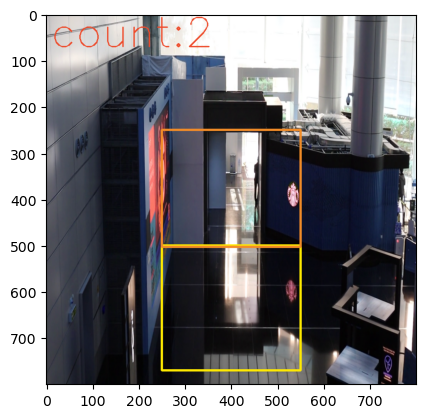

1/1 [==============================] - 1s 944ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 47


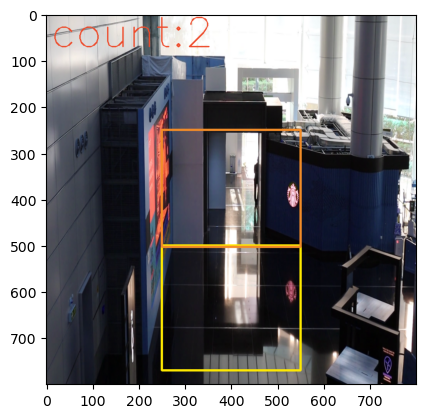

1/1 [==============================] - 1s 995ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 48


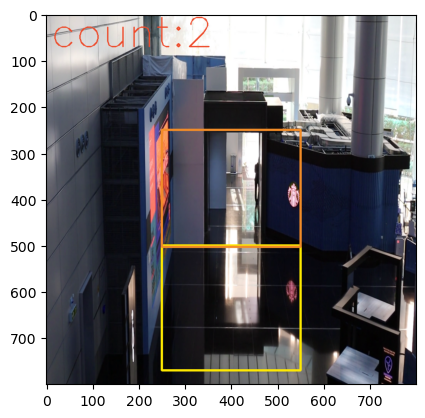

1/1 [==============================] - 1s 919ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 49


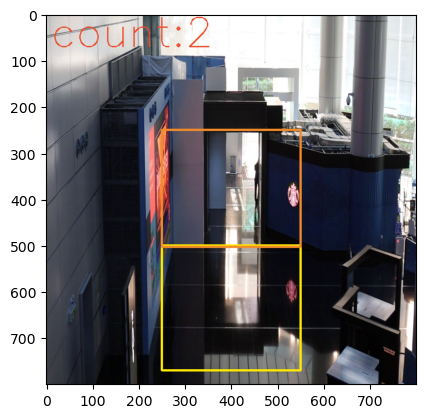

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 50


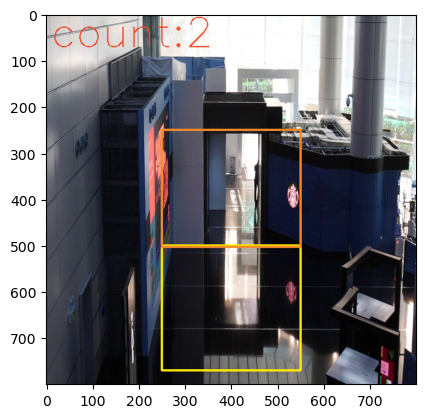

1/1 [==============================] - 1s 936ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 51


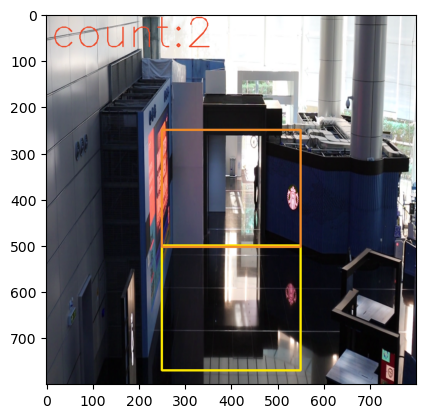

1/1 [==============================] - 1s 934ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 52


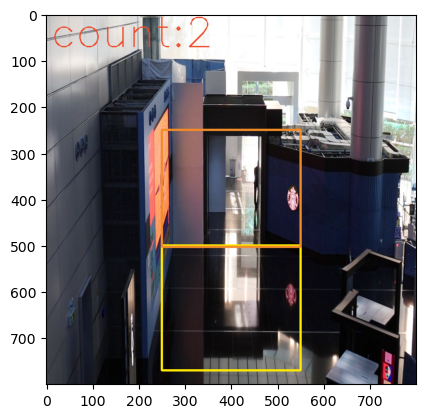

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 53


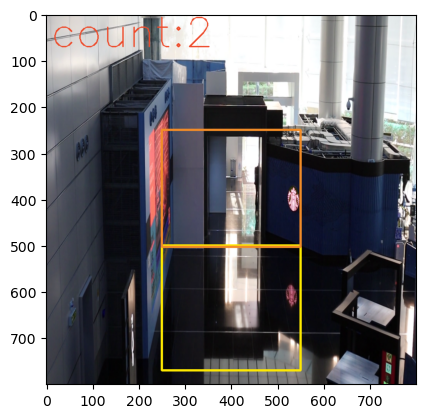

1/1 [==============================] - 1s 937ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 54


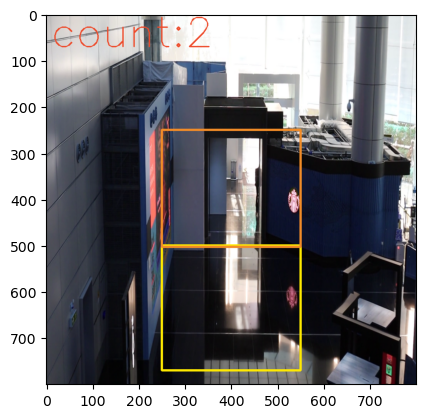

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 55


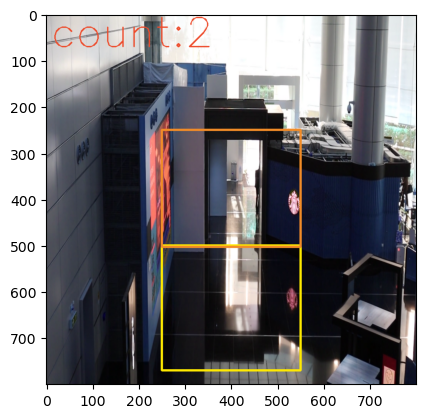

1/1 [==============================] - 1s 954ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 56


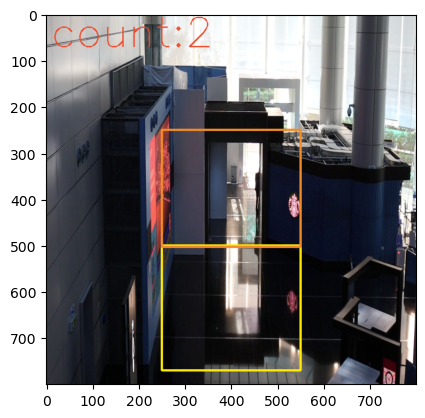

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 57


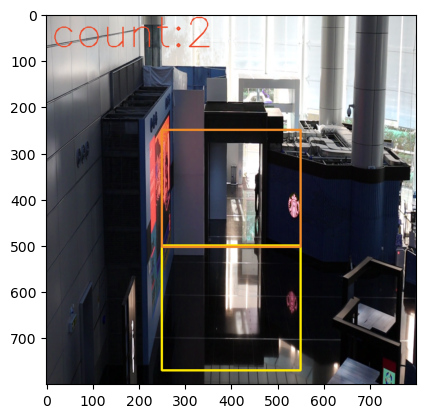

1/1 [==============================] - 1s 994ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 58


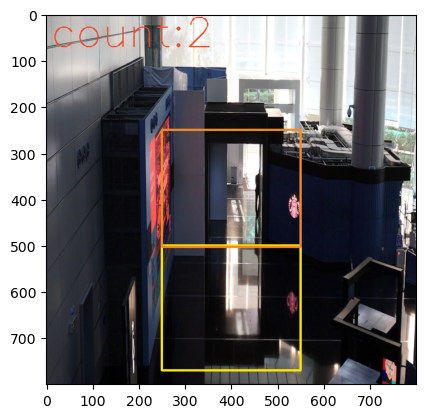

1/1 [==============================] - 1s 929ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 59


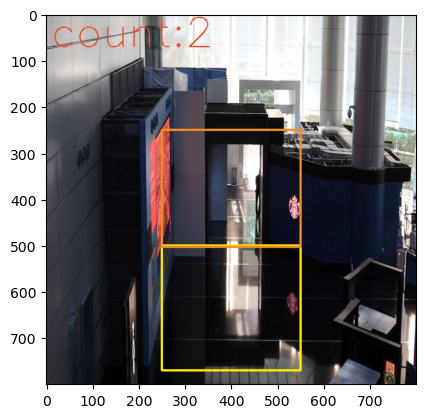

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 60


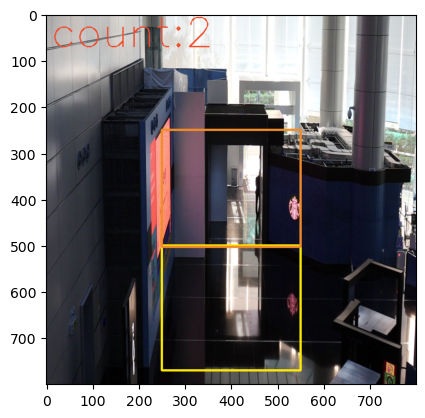

1/1 [==============================] - 1s 929ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 61


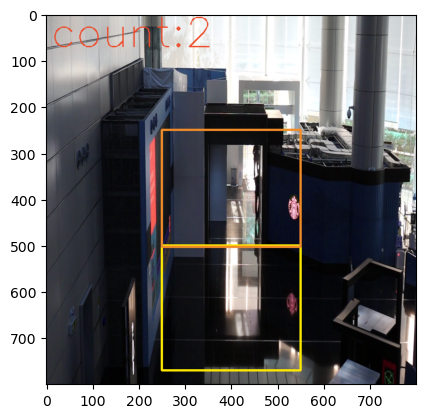

1/1 [==============================] - 1s 943ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 62


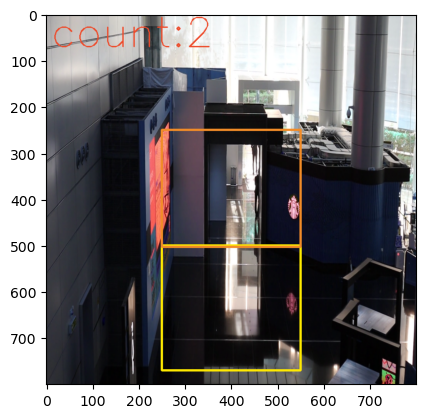

1/1 [==============================] - 1s 989ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 63


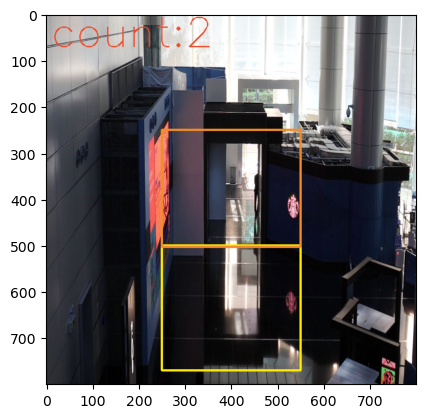

1/1 [==============================] - 1s 926ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 64


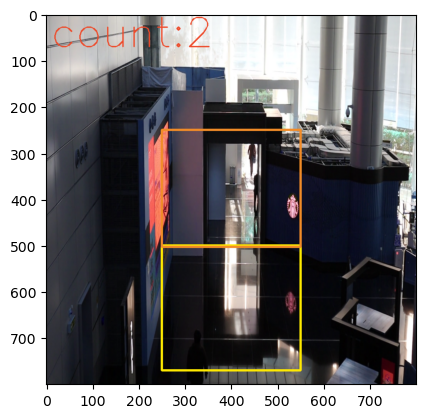

1/1 [==============================] - 1s 948ms/step
person 64.1123116016388
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0)]
1 0 65
cy: 1 co: 0 count: 2 pre_yellow: 2 pre_frame: 3 55


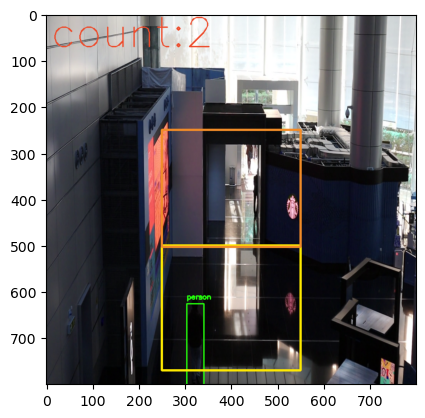

1/1 [==============================] - 1s 979ms/step
person 92.50897765159607
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0)]
1 0 66
cy: 1 co: 0 count: 2 pre_yellow: 2 pre_frame: 4 56


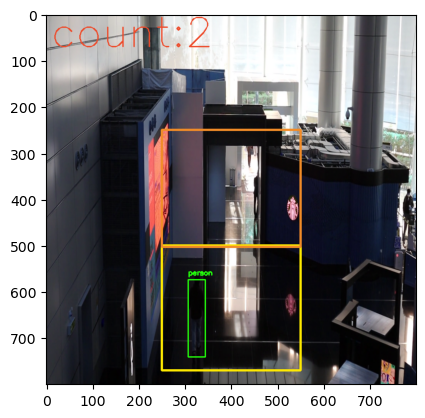

1/1 [==============================] - 1s 935ms/step
person 67.97212958335876
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0)]
1 0 67
cy: 1 co: 0 count: 2 pre_yellow: 2 pre_frame: 1 57


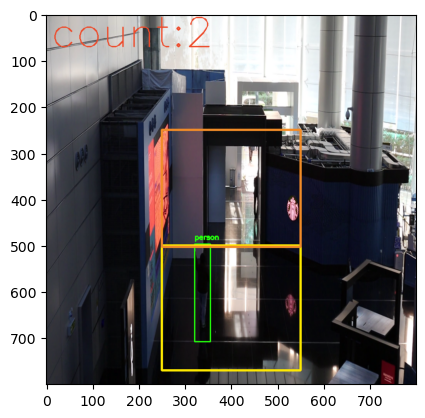

1/1 [==============================] - 1s 943ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0)]
0 0 68


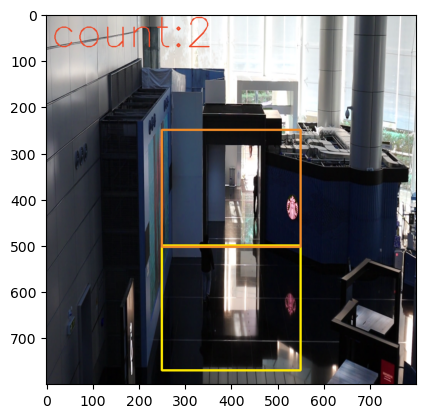

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0)]
0 0 69


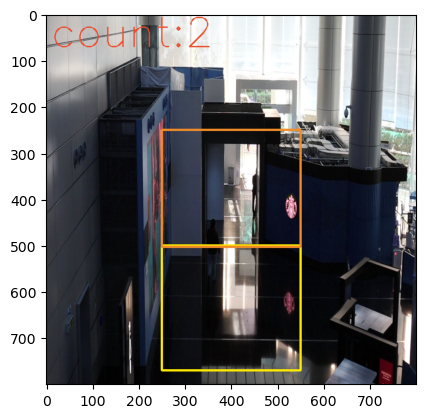

1/1 [==============================] - 1s 998ms/step
person 68.9554750919342
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1)]
0 1 70
cy: 0 co: 1 count: 2 pre_yellow: 2 pre_frame: 4 60


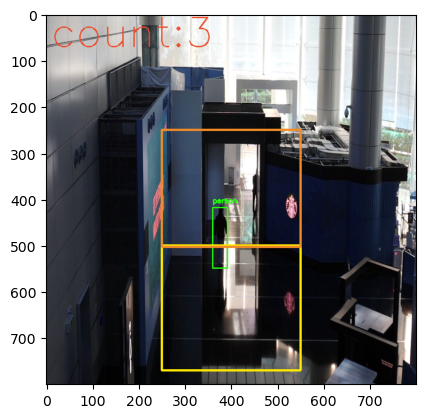

1/1 [==============================] - 1s 976ms/step
person 84.31184887886047
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1)]
0 1 71
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 61


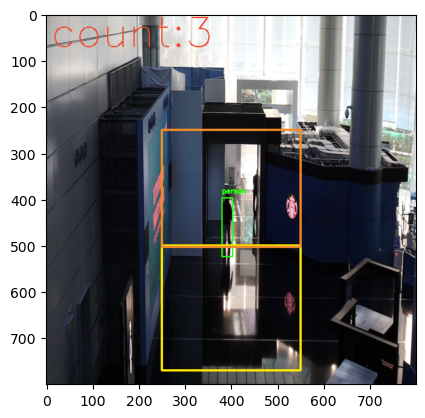

1/1 [==============================] - 1s 990ms/step
person 94.54625844955444
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1)]
0 1 72
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 62


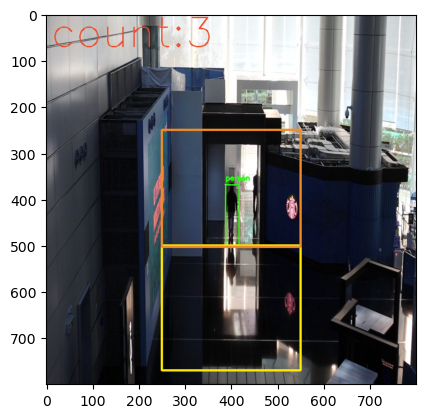

1/1 [==============================] - 1s 969ms/step
person 97.2065269947052
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1)]
0 1 73
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 63


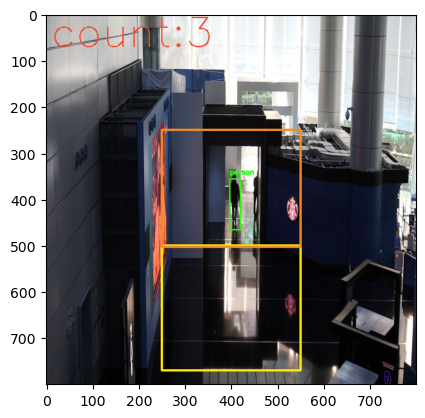

1/1 [==============================] - 1s 940ms/step
person 97.26220965385437
person 65.83583354949951
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2)]
0 2 74
cy: 0 co: 2 count: 3 pre_yellow: 1 pre_frame: 1 64


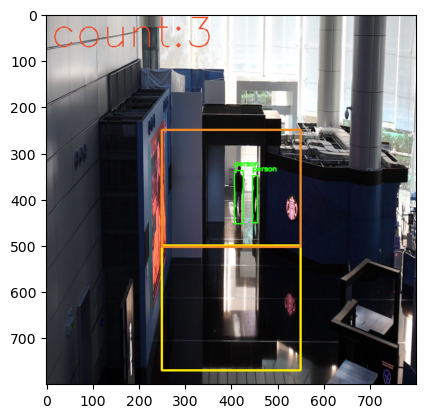

1/1 [==============================] - 1s 980ms/step
person 75.41999220848083
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1)]
0 1 75
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 65


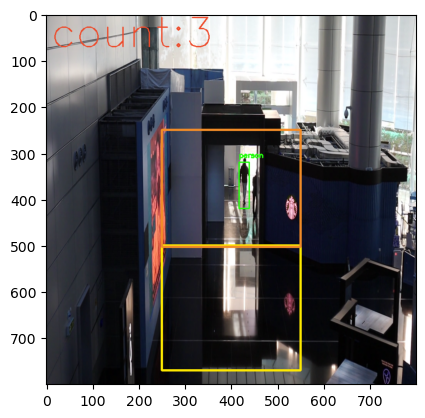

1/1 [==============================] - 1s 923ms/step
person 70.91166377067566
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1)]
0 1 76
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 66


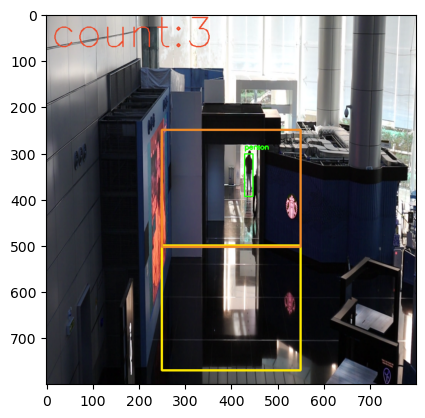

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0)]
0 0 77


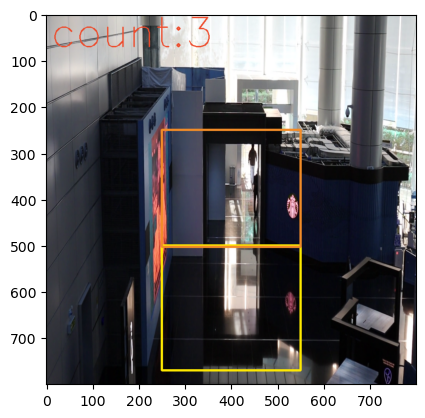

1/1 [==============================] - 1s 934ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0)]
0 0 78


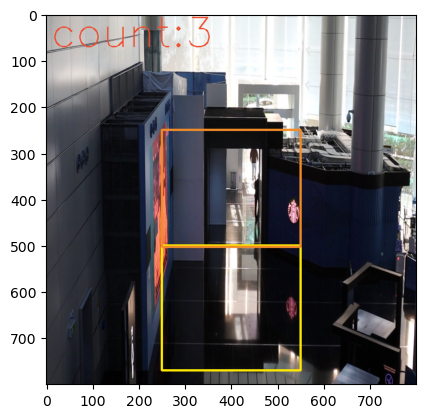

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0)]
0 0 79


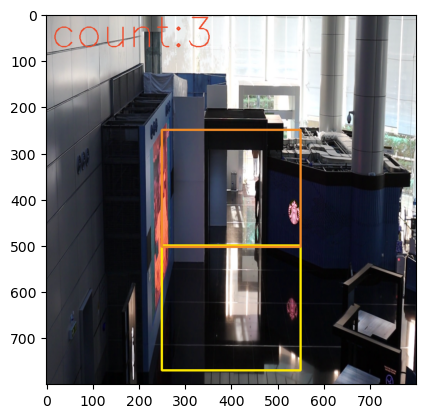

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 80


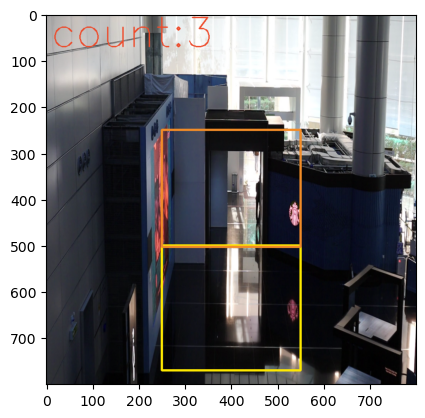

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 81


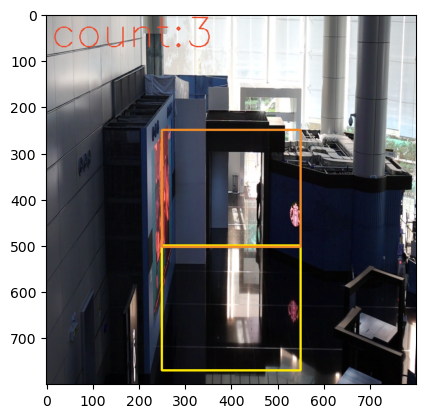

1/1 [==============================] - 1s 1s/step
person 60.60688495635986
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 82


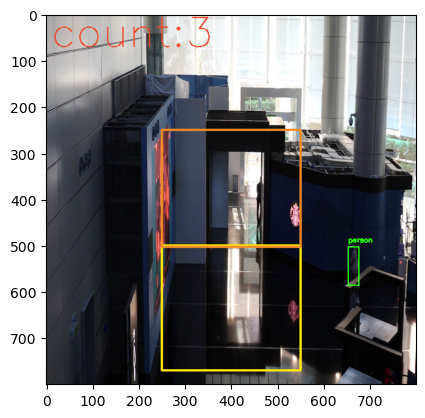

1/1 [==============================] - 1s 945ms/step
person 80.73841333389282
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 83


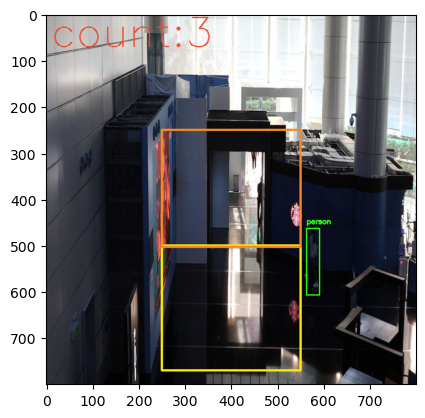

1/1 [==============================] - 1s 922ms/step
person 96.62137627601624
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1)]
0 1 84
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 4 74


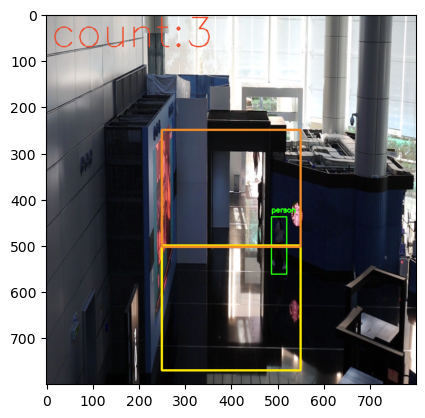

1/1 [==============================] - 1s 946ms/step
person 82.77971744537354
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1)]
0 1 85
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 75


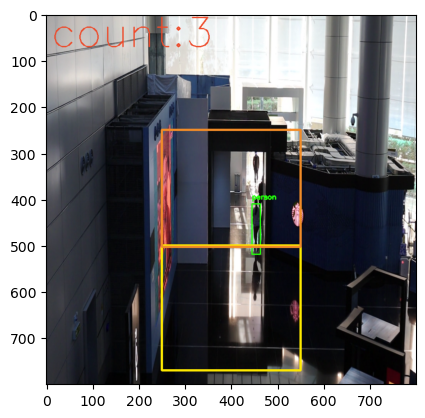

1/1 [==============================] - 1s 950ms/step
person 79.4914722442627
person 89.15684819221497
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2)]
0 2 86
cy: 0 co: 2 count: 3 pre_yellow: 1 pre_frame: 1 76


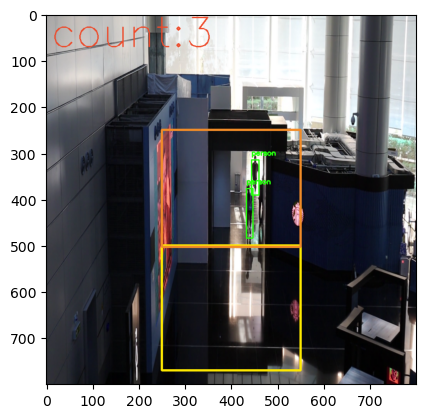

1/1 [==============================] - 1s 935ms/step
person 82.64805674552917
person 83.92853140830994
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2)]
0 2 87
cy: 0 co: 2 count: 3 pre_yellow: 1 pre_frame: 1 77


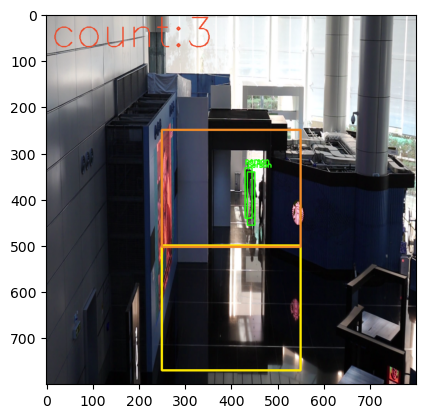

1/1 [==============================] - 1s 945ms/step
person 99.32220578193665
person 72.00056314468384
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2)]
0 2 88
cy: 0 co: 2 count: 3 pre_yellow: 1 pre_frame: 1 78


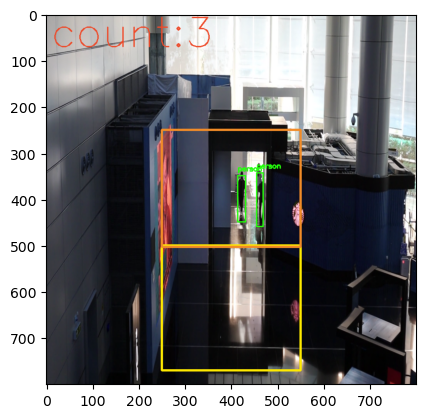

1/1 [==============================] - 1s 932ms/step
person 96.05194330215454
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1)]
0 1 89
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 79


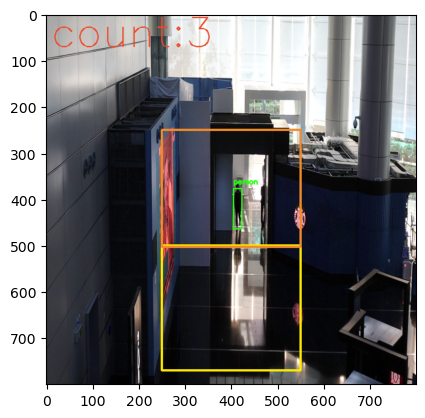

1/1 [==============================] - 1s 1s/step
person 90.75613617897034
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1)]
0 1 90
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 80


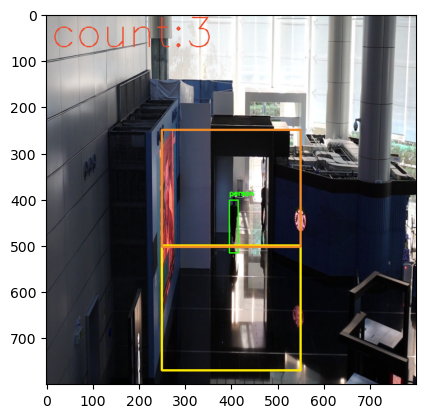

1/1 [==============================] - 1s 939ms/step
person 85.65276265144348
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1)]
0 1 91
cy: 0 co: 1 count: 3 pre_yellow: 1 pre_frame: 1 81


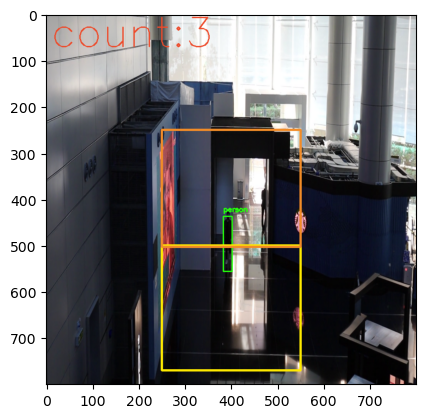

1/1 [==============================] - 1s 930ms/step
car 66.49938225746155
person 72.6801872253418
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0)]
1 0 92
cy: 1 co: 0 count: 3 pre_yellow: 1 pre_frame: 1 82


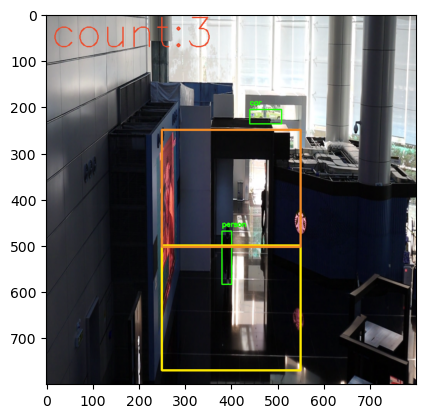

1/1 [==============================] - 1s 935ms/step
person 79.6618103981018
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0)]
1 0 93
cy: 1 co: 0 count: 3 pre_yellow: 1 pre_frame: 1 83


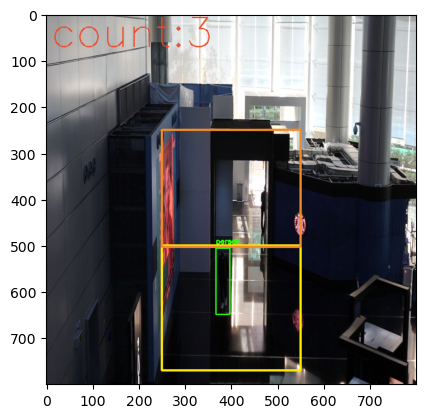

1/1 [==============================] - 1s 1s/step
person 68.6673104763031
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0)]
1 0 94
cy: 1 co: 0 count: 3 pre_yellow: 1 pre_frame: 1 84


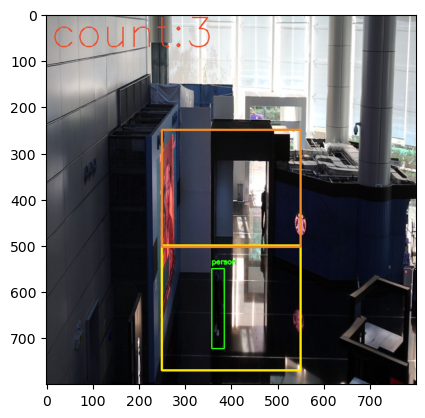

1/1 [==============================] - 1s 960ms/step
person 97.68247604370117
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0)]
1 0 95
cy: 1 co: 0 count: 3 pre_yellow: 1 pre_frame: 1 85


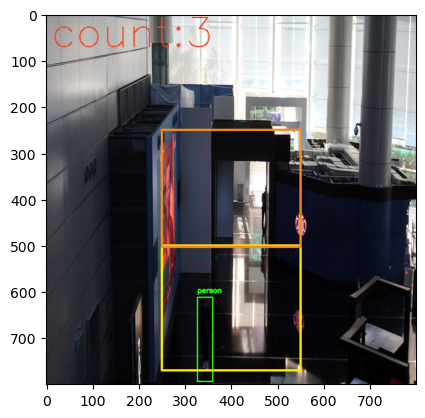

1/1 [==============================] - 1s 939ms/step
person 73.60323667526245
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0)]
1 0 96
cy: 1 co: 0 count: 3 pre_yellow: 1 pre_frame: 1 86


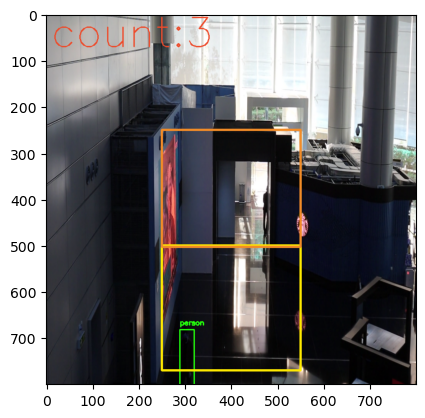

1/1 [==============================] - 1s 948ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0)]
0 0 97


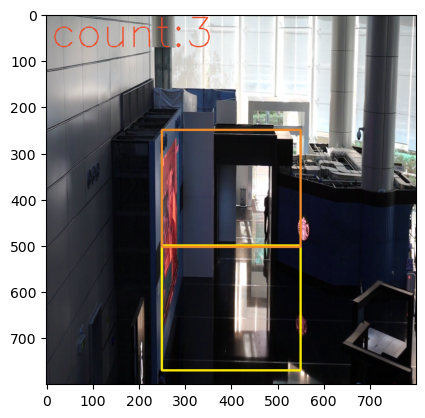

1/1 [==============================] - 1s 923ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0)]
0 0 98


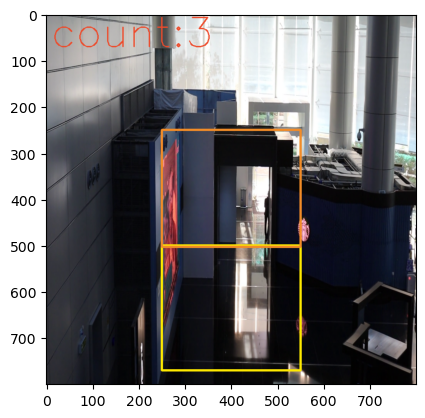

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0)]
0 0 99


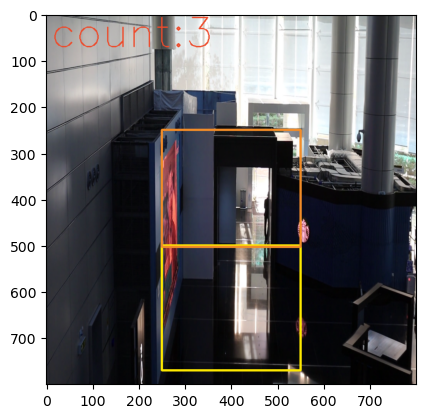

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 100


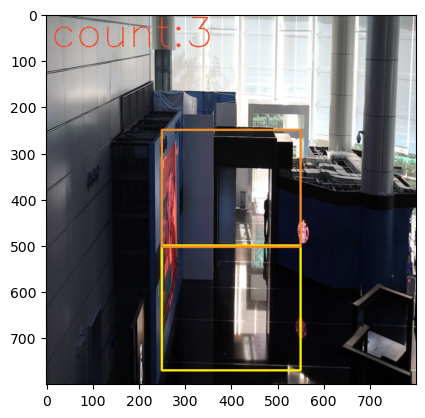

1/1 [==============================] - 1s 924ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 101


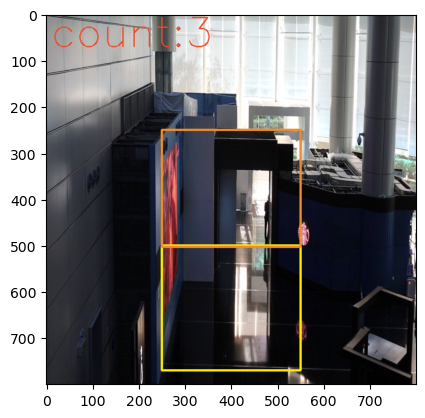

1/1 [==============================] - 1s 935ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 102


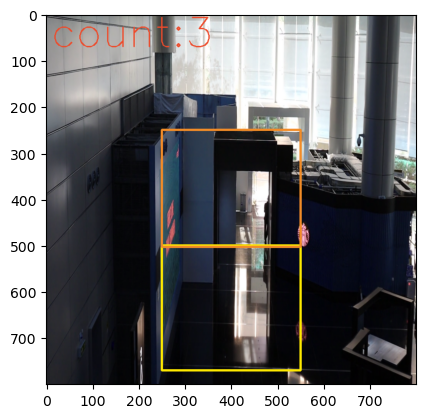

1/1 [==============================] - 1s 950ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 103


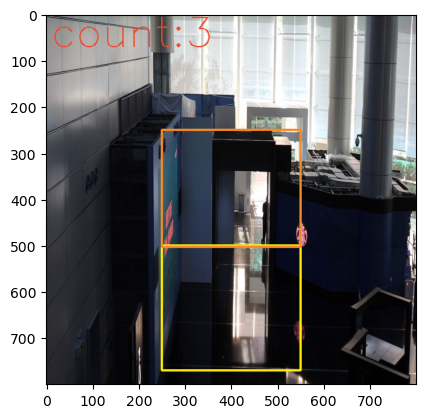

1/1 [==============================] - 1s 969ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 104


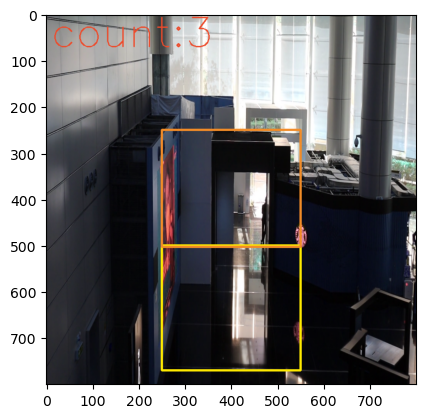

1/1 [==============================] - 1s 989ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 105


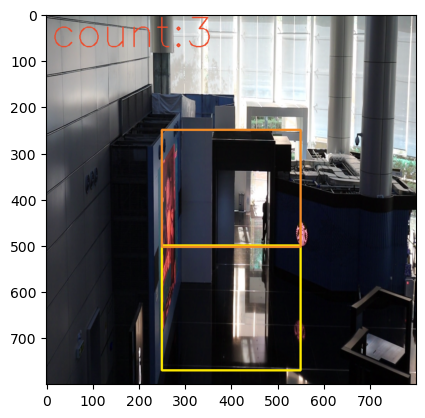

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 106


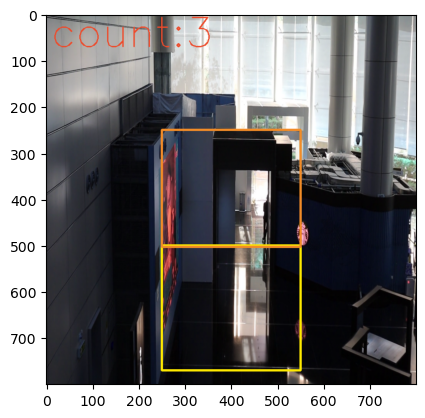

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 107


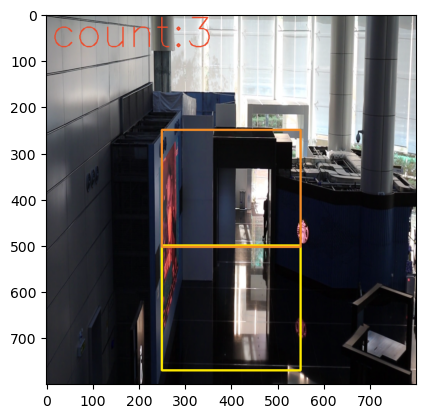

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 108


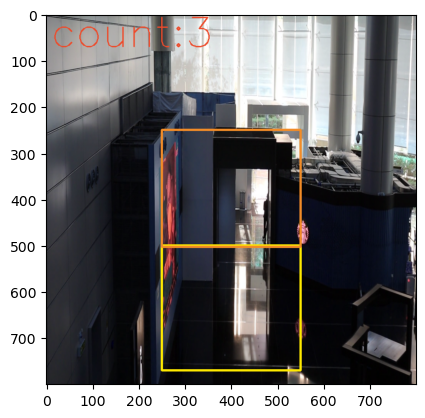

1/1 [==============================] - 1s 937ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 109


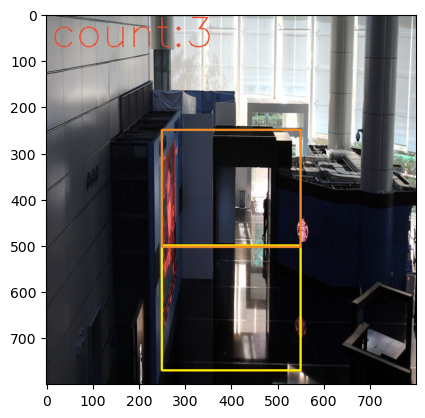

1/1 [==============================] - 1s 920ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 110


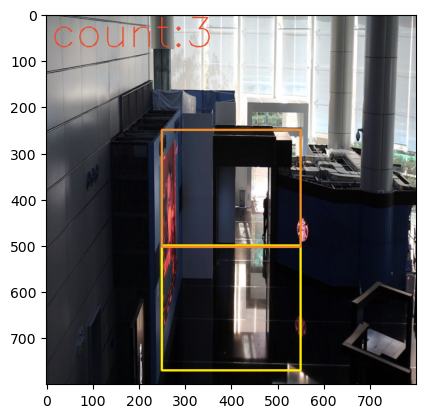

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 111


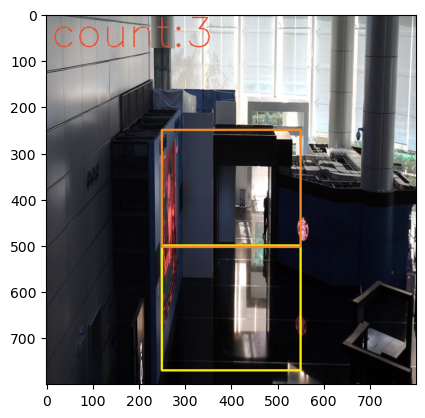

1/1 [==============================] - 1s 984ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 112


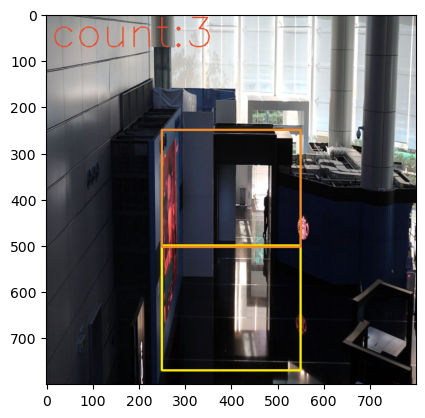

1/1 [==============================] - 1s 928ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 113


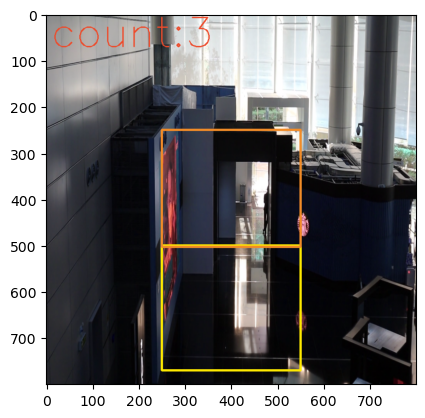

1/1 [==============================] - 1s 941ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 114


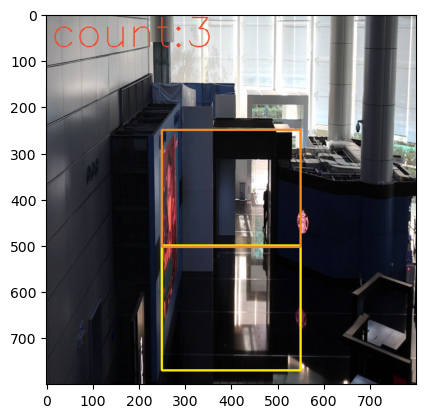

1/1 [==============================] - 1s 972ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 115


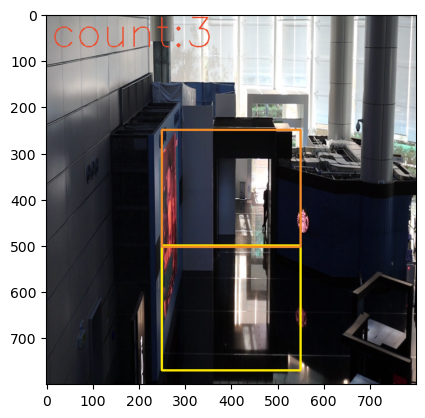

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 116


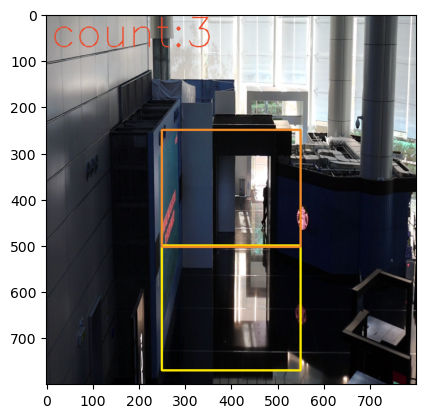

1/1 [==============================] - 1s 1s/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 117


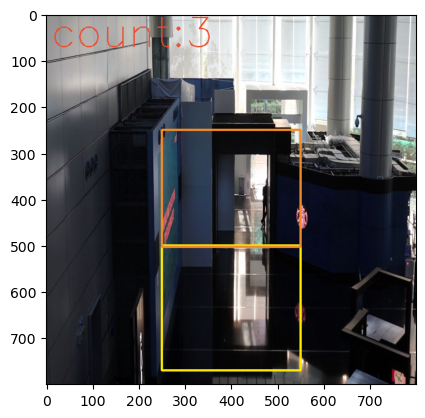

1/1 [==============================] - 1s 977ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 118


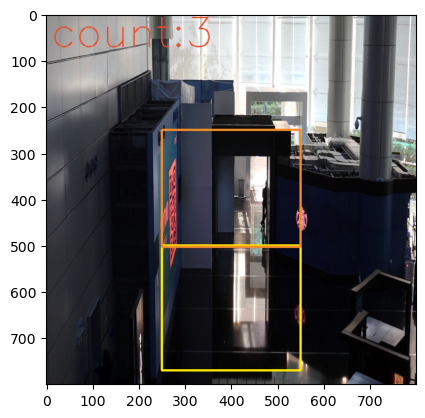

1/1 [==============================] - 1s 935ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 119


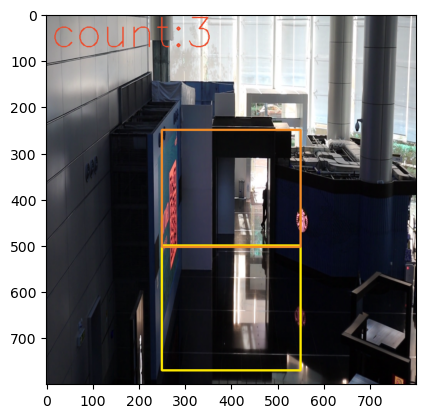

1/1 [==============================] - 1s 927ms/step
[(0, 0), (1, 0), (2, 0), (2, 0), (2, 0), (2, 0), (0, 1), (0, 2), (0, 2), (0, 2), (0, 3), (0, 2), (0, 2), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 1), (0, 1), (0, 2), (0, 1), (0, 1), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 1), (0, 1), (0, 2), (0, 2), (0, 2), (0, 1), (0, 1), (0, 1), (1, 0), (1, 0), (1, 0), (1, 0), (1, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0), (0, 0)]
0 0 120


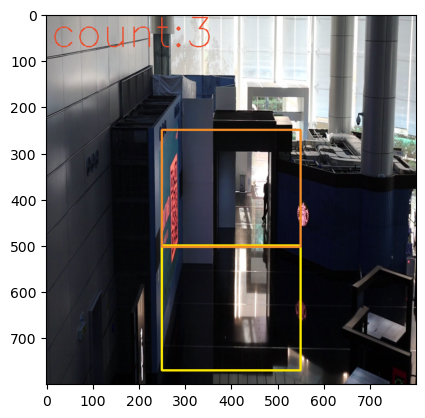

In [123]:
# Preparing variable for result that we will use to write processed frames
# scale_percent = 30 # percent of original size
# input_w = int(1920 * scale_percent / 100)
# input_h = int(1080 * scale_percent / 100)
input_w = 800
input_h = 800
#count number of ppl pass from yellow box to orange box in vedio
start = 10
count = 0
frame_pointer = 0
fps = 1500
count_hist = []
pre_yellow = 0
skip_previous_frame = False
pre_frame = 1
# Read until video is completed
while True:
    # Capture frame-by-frame, every 1.5s
    cap.set(cv2.CAP_PROP_POS_MSEC,(start*fps))
    ret, frame = cap.read() # this line will read frame one by one in the video in each loop

    # If the frame was not retrieved e.g.: at the end of the video, then we break the loop
    if not ret:
       break

    # # (optional) resize frame
    # scale_percent = 30 # percent of original size
    # width = int(frame.shape[1] * scale_percent / 100)
    # height = int(frame.shape[0] * scale_percent / 100)
    # dim = (width, height)
    # frame = cv2.resize(frame, dim, interpolation = cv2.INTER_AREA)


    # insert your logic here
    # the first one is to do yolo detection on the frame
    # need to copy the yolo functions
    resizedFrame = cv2.resize(frame, (input_w, input_h), interpolation = cv2.INTER_AREA)
    image_w = resizedFrame.shape[0]
    image_h = resizedFrame.shape[1]
    resizedFrame = (resizedFrame[...,::-1].astype(np.float32)) / 255.0
    yhat = yolov3.predict(expand_dims(resizedFrame, 0))
    resizedFrame = (cv2.cvtColor(resizedFrame, cv2.COLOR_BGR2RGB)*255).astype(np.uint8)

    if len(yhat) > 0 and yhat is not None:
      boxes = list()
      for i in range(len(yhat)):
        # decode the output of the network
        boxes += decode_netout(yhat[i][0], anchors[i], class_threshold, input_h, input_w)

      # correct the sizes of the bounding boxes for the shape of the image
      correct_yolo_boxes(boxes, image_h, image_w, input_h, input_w)

      # suppress non-maximal boxes
      do_nms(boxes, 0.5)

      # get the details of the detected objectsw
      v_boxes, v_labels, v_scores = get_boxes(boxes, labels, class_threshold)


      # if len(v_boxes) > 0:
      #   # then you need to compute which ones belong to the last one
      #   sizeOfBoxes = [(b.xmax - b.xmin) * (b.ymax - b.ymin) for b in v_boxes]
      #   targetPersonBox = np.argmax(sizeOfBoxes)
      #   box = v_boxes[targetPersonBox]

      count_yellow = 0
      count_orange = 0
      for i in range(len(v_boxes)):
        box = v_boxes[i]
        print(v_labels[i], v_scores[i])
        cv2.rectangle(resizedFrame, (box.xmin, box.ymin), (box.xmax, box.ymax),(36,255,12), 2)
        cv2.putText(resizedFrame, v_labels[i], (box.xmin, box.ymin-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (36,255,12), 2)

        #count number of ppl in yellow and orange box and only count label = person
        if(v_labels[i] == 'person' and 250 < (box.xmax + box.xmin)/2< 550  and 500 < (box.ymax +  box.ymin)/2< 770 ):
            count_yellow += 1
        if(v_labels[i] == 'person' and 250 < (box.xmax + box.xmin)/2 < 550  and 250 < (box.ymax +  box.ymin ) /2< 503 ):
            count_orange += 1

    #count number of ppl pass from yellow box orange box
    count_hist.append((count_yellow , count_orange))
    print(count_hist)
    print(count_yellow , count_orange,start)
    if frame_pointer >1:
        if pre_frame >4:
            pre_frame= 1
        py =count_hist[frame_pointer-pre_frame][0]
        cy =count_hist[frame_pointer][0]
        po =count_hist[frame_pointer-pre_frame][1]
        co =count_hist[frame_pointer][1]
        if(cy ==0 and co ==0):
            pre_frame= pre_frame +1
        else:
            print('cy:',cy ,'co:', co ,'count:', count, 'pre_yellow:',pre_yellow ,'pre_frame:',pre_frame,frame_pointer)
            if py != cy and po < co:
                pre_yellow = py
                count +=1
                pre_frame=1
            if(cy + co < pre_yellow):
                pre_frame = pre_frame +1
            else:
                pre_frame = 1
#     if frame_pointer >1:
#         py =count_hist[frame_pointer-1][0]
#         cy =count_hist[frame_pointer][0]
#         po =count_hist[frame_pointer-1][1]
#         co =count_hist[frame_pointer][1]

#     if(skip_previous_frame):
#         py =count_hist[frame_pointer-2][0]
#         po =count_hist[frame_pointer-2][1]
#         skip_previous_frame = False


#     if py != cy and po < co:
#         pre_yellow = py
#         count +=1
#     if(cy + co < pre_yellow):
#         skip_previous_frame = True

    cv2.putText(resizedFrame, 'count:'+str(count), (10, 70), cv2.FONT_HERSHEY_SIMPLEX, 3, (238, 75, 43), 2)
    cv2.rectangle(resizedFrame, (250, 500), (550, 770),(255, 234, 0), 3)
    cv2.rectangle(resizedFrame, (250, 250), (550, 503),(242, 140, 40), 3)
#     imshow(resizedFrame)


    imshow(resizedFrame)
    pyplot.show()
    # save the frame into to object 
    result.write(resizedFrame)
    start = start + 1
    frame_pointer = frame_pointer +1

    # Display the resulting frame

    # Press Q on keyboard to  exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break 

   
# When everything done, release the video capture object
cap.release()
result.release()

# Closes all the frames
cv2.destroyAllWindows()